In [ ]:
!pip install kaggle

from google.colab import files
files.upload()

!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

!kaggle datasets download andrewmvd/animal-faces

!unzip animal-faces.zip

!rm animal-faces.zip

Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
  inflating: afhq/train/wild/flickr_wild_001378.jpg  
  inflating: afhq/train/wild/flickr_wild_001379.jpg  
  inflating: afhq/train/wild/flickr_wild_001380.jpg  
  inflating: afhq/train/wild/flickr_wild_001381.jpg  
  inflating: afhq/train/wild/flickr_wild_001382.jpg  
  inflating: afhq/train/wild/flickr_wild_001384.jpg  
  inflating: afhq/train/wild/flickr_wild_001385.jpg  
  inflating: afhq/train/wild/flickr_wild_001386.jpg  
  inflating: afhq/train/wild/flickr_wild_001387.jpg  
  inflating: afhq/train/wild/flickr_wild_001388.jpg  
  inflating: afhq/train/wild/flickr_wild_001389.jpg  
  inflating: afhq/train/wild/flickr_wild_001390.jpg  
  inflating: afhq/train/wild/flickr_wild_001391.jpg  
  inflating: afhq/train/wild/flickr_wild_001392.jpg  
  inflating: afhq/train/wild/flickr_wild_001393.jpg  
  inflating: afhq/train/wild/flickr_wild_001394.jpg  
  inflating: afhq/train/wild/flickr_wild_001395.jpg  
  inflating: afhq

In [ ]:
import cv2
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
import numpy as np
import os
from sklearn.model_selection import train_test_splita
from torchvision.models import vgg19

In [ ]:
from google.colab.patches import cv2_imshow

imshow = cv2_imshow

In [ ]:
class ImageDataset(Dataset):
    def __init__(self, input_images, target_images, transform=None):
        self.input_images = input_images
        self.target_images = target_images
        self.transform = transform

    def __len__(self):
        return len(self.input_images)

    def __getitem__(self, idx):
        input_image = self.input_images[idx]
        target_image = self.target_images[idx]

        input_image = torch.from_numpy(input_image.transpose((2, 0, 1))).float()
        target_image = torch.from_numpy(target_image.transpose((2, 0, 1))).float()

        if self.transform:
            input_image = self.transform(input_image)
            target_image = self.transform(target_image)

        return input_image, target_image


def normalize_1_1(tensor):
    return tensor / 127.5 - 1.0


def load_images(filepath, limit=np.inf):
    images = []

    count = 0
    for filename in os.listdir(filepath):
        if filename.endswith(".jpg"):
            curr_filepath = os.path.join(filepath, filename)
            image = cv2.imread(curr_filepath)

            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            if image is not None:
                images.append(image)

        count += 1
        if count > limit:
            break

    return images

def predict_on_image(input_image, model, device):
    model.eval()
    with torch.no_grad():
        input_image = torch.from_numpy(input_image.transpose((2, 0, 1))).float()
        input_image = normalize_1_1(input_image).unsqueeze(0).to(device)

        output = model(input_image).squeeze(0)
        output = (output + 1) * 127.5
        output = output.permute(1, 2, 0).cpu().numpy()
        return np.clip(output, 0, 255).astype(np.uint8)

In [ ]:
class SimpleNet(nn.Module):
    def __init__(self):
        super(SimpleNet, self).__init__()

        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, stride=1, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),

            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(128),
        )

        self.decoder = nn.Sequential(
            nn.Conv2d(128, 64, kernel_size=3, stride=1, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),

            nn.Conv2d(64, 3, kernel_size=3, stride=1, padding=1),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

In [ ]:
class ResidualBlock(nn.Module):
    def __init__(self, channels):
        super(ResidualBlock, self).__init__()
        self.block = nn.Sequential(
            nn.Conv2d(channels, channels, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(channels),
            nn.PReLU(),
            nn.Conv2d(channels, channels, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(channels)
        )

    def forward(self, x):
        return x + self.block(x)

class Generator(nn.Module):
    def __init__(self, num_residual_blocks=8):
        super(Generator, self).__init__()
        self.initial_conv = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=9, stride=1, padding=4),
            nn.PReLU()
        )

        self.residual_blocks = nn.Sequential(
            *[ResidualBlock(64) for _ in range(num_residual_blocks)]
        )

        self.mid_conv = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64)
        )

        self.upsample = nn.Sequential(
            nn.Conv2d(64, 256, kernel_size=3, stride=1, padding=1),
            nn.PixelShuffle(upscale_factor=2),
            nn.PReLU()
        )

        self.final_conv = nn.Conv2d(64, 3, kernel_size=9, stride=1, padding=4)

    def forward(self, x):
        initial_features = self.initial_conv(x)
        residual_features = self.residual_blocks(initial_features)
        mid_features = self.mid_conv(residual_features)
        upsampled_features = self.upsample(mid_features + initial_features)
        return self.final_conv(upsampled_features)


class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1)
        self.conv2 = nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1)
        self.conv3 = nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1)
        self.conv4 = nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1)

        self.fc1 = nn.Linear(512 * 32 * 32, 1024)
        self.fc2 = nn.Linear(1024, 1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        x = F.leaky_relu(self.conv1(x), 0.2)
        x = F.leaky_relu(self.conv2(x), 0.2)
        x = F.leaky_relu(self.conv3(x), 0.2)
        x = F.leaky_relu(self.conv4(x), 0.2)

        x = x.view(x.size(0), -1)

        x = F.leaky_relu(self.fc1(x), 0.2)
        x = self.fc2(x)
        return self.sigmoid(x)


pixel_loss = nn.MSELoss()

class VGGFeatureExtractor(nn.Module):
    def __init__(self):
        super(VGGFeatureExtractor, self).__init__()
        vgg = vgg19(pretrained=True)
        self.feature_extractor = nn.Sequential(*list(vgg.features[:36]))

    def forward(self, x):
        return self.feature_extractor(x)

adversarial_loss = nn.BCEWithLogitsLoss()

In [ ]:
!rm ./*.pth

rm: cannot remove './*.pth': No such file or directory


In [ ]:
target_images = load_images("/content/afhq/val/cat") + load_images("/content/afhq/val/dog") + load_images("/content/afhq/val/wild")
test_image = target_images.pop(1)
input_images = [cv2.resize(img, (256, 256), interpolation=cv2.INTER_AREA) for img in target_images]

train_inputs, val_inputs, train_targets, val_targets = train_test_split(
    input_images, target_images, test_size=0.2, random_state=42
)

train_dataset = ImageDataset(train_inputs, train_targets, transform=normalize_1_1)
val_dataset = ImageDataset(val_inputs, val_targets, transform=normalize_1_1)

train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False)

num_epochs = 20
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

generator = Generator().to(device)
discriminator = Discriminator().to(device)
feature_extractor = VGGFeatureExtractor().to(device)

optimizer_G = torch.optim.Adam(generator.parameters(), lr=1e-4)
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=1e-4)

best_val_loss = float('inf')
patience = 4
stopping_counter = 0

for epoch in range(num_epochs):
    #### Train Phase ####
    generator.train()
    discriminator.train()
    running_train_loss_D = 0.0
    running_train_loss_G = 0.0

    for lr_images, hr_images in train_loader:
        lr_images, hr_images = lr_images.to(device), hr_images.to(device)

        # Train Discriminator
        optimizer_D.zero_grad()
        fake_hr = generator(lr_images)
        real_output = discriminator(hr_images)
        fake_output = discriminator(fake_hr.detach())
        real_labels = torch.ones_like(real_output)
        fake_labels = torch.zeros_like(fake_output)
        loss_D = adversarial_loss(real_output, real_labels) + adversarial_loss(fake_output, fake_labels)
        loss_D.backward()
        optimizer_D.step()

        running_train_loss_D += loss_D.item()

        # Train Generator
        optimizer_G.zero_grad()
        fake_hr = generator(lr_images)
        fake_output = discriminator(fake_hr)
        perceptual_loss = pixel_loss(fake_hr, hr_images) + \
                          0.006 * adversarial_loss(fake_output, real_labels) + \
                          0.006 * pixel_loss(feature_extractor(fake_hr), feature_extractor(hr_images))
        perceptual_loss.backward()
        optimizer_G.step()

        running_train_loss_G += perceptual_loss.item()

    avg_train_loss_D = running_train_loss_D / len(train_loader)
    avg_train_loss_G = running_train_loss_G / len(train_loader)

    #### Validation Phase ####
    generator.eval()
    running_val_loss_G = 0.0

    with torch.no_grad():
        for val_lr_images, val_hr_images in val_loader:
            val_lr_images, val_hr_images = val_lr_images.to(device), val_hr_images.to(device)

            val_fake_hr = generator(val_lr_images)
            val_perceptual_loss = pixel_loss(val_fake_hr, val_hr_images) + \
                                  0.006 * pixel_loss(feature_extractor(val_fake_hr), feature_extractor(val_hr_images))
            running_val_loss_G += val_perceptual_loss.item()

    avg_val_loss_G = running_val_loss_G / len(val_loader)

    print(f"Epoch [{epoch+1}/{num_epochs}] - "
          f"Train Loss D: {avg_train_loss_D:.4f}, Train Loss G: {avg_train_loss_G:.4f}, "
          f"Val Loss G: {avg_val_loss_G:.4f}")

    if avg_val_loss_G < best_val_loss - 0.0002:
        best_val_loss = avg_val_loss_G
        stopping_counter = 0

        torch.save(generator.state_dict(), "best_generator.pth")
    else:
        stopping_counter += 1

    if stopping_counter >= patience:
        break

generator.load_state_dict(torch.load("best_generator.pth"))
print("Training complete")

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:02<00:00, 220MB/s]


Epoch [1/20] - Train Loss D: 1.3864, Train Loss G: 0.0256, Val Loss G: 0.0088
Epoch [2/20] - Train Loss D: 1.3863, Train Loss G: 0.0128, Val Loss G: 0.0067
Epoch [3/20] - Train Loss D: 1.3863, Train Loss G: 0.0112, Val Loss G: 0.0061
Epoch [4/20] - Train Loss D: 1.3863, Train Loss G: 0.0105, Val Loss G: 0.0060
Epoch [5/20] - Train Loss D: 1.3863, Train Loss G: 0.0103, Val Loss G: 0.0058
Epoch [6/20] - Train Loss D: 1.3863, Train Loss G: 0.0101, Val Loss G: 0.0055
Epoch [7/20] - Train Loss D: 1.3863, Train Loss G: 0.0099, Val Loss G: 0.0056
Epoch [8/20] - Train Loss D: 1.3863, Train Loss G: 0.0098, Val Loss G: 0.0054
Epoch [9/20] - Train Loss D: 1.3863, Train Loss G: 0.0097, Val Loss G: 0.0053
Epoch [10/20] - Train Loss D: 1.3863, Train Loss G: 0.0096, Val Loss G: 0.0054
Epoch [11/20] - Train Loss D: 1.3863, Train Loss G: 0.0096, Val Loss G: 0.0054
Epoch [12/20] - Train Loss D: 1.3863, Train Loss G: 0.0095, Val Loss G: 0.0052
Epoch [13/20] - Train Loss D: 1.3863, Train Loss G: 0.0095, V

<ipython-input-9-5cb8630ff0d2>:97: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load("best_generator.pth"))


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

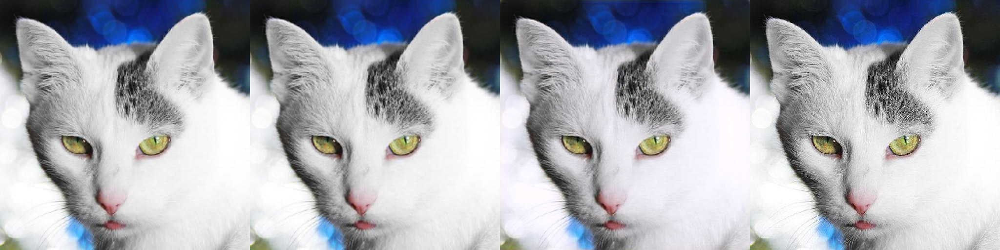

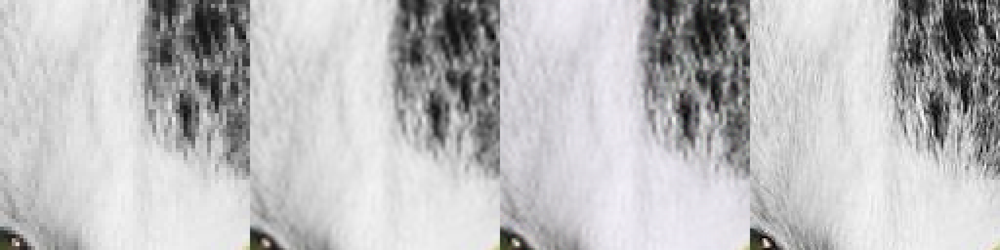

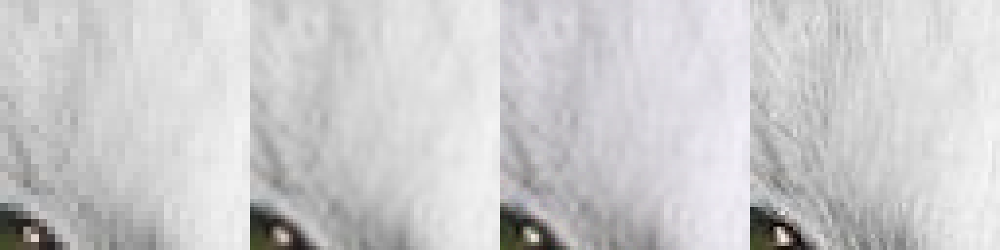

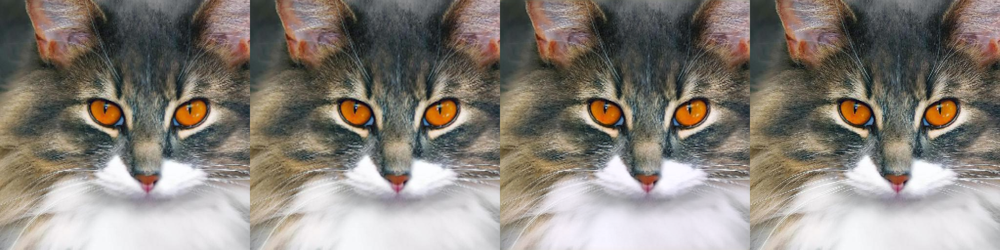

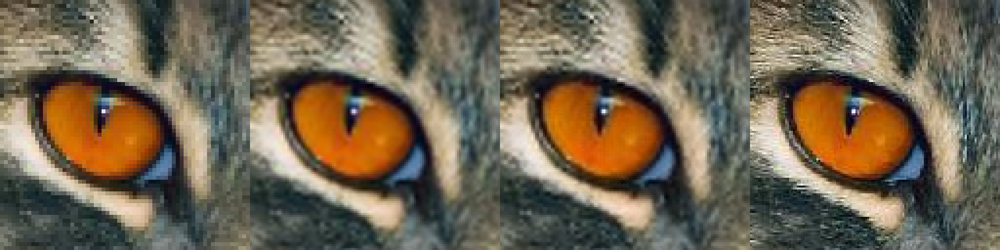

...

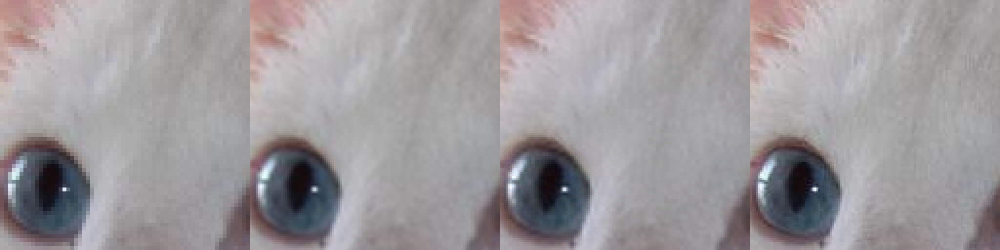

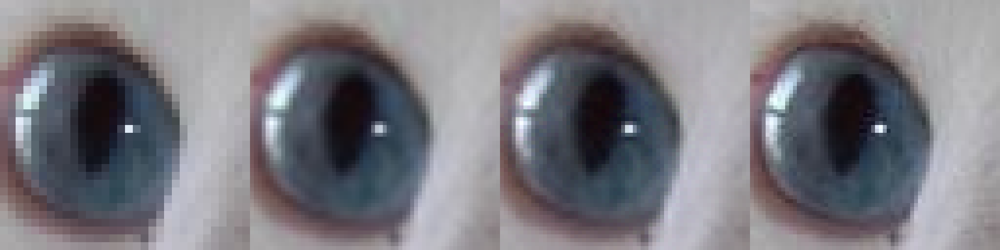

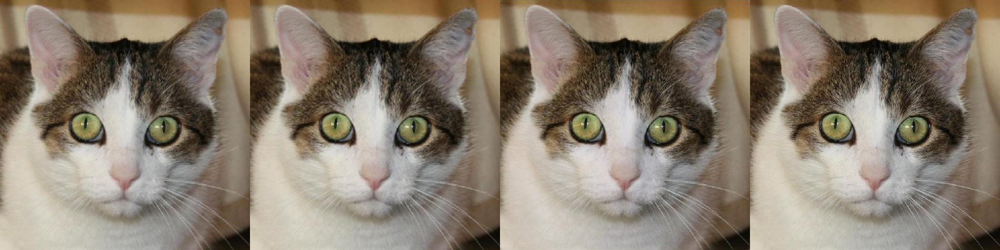

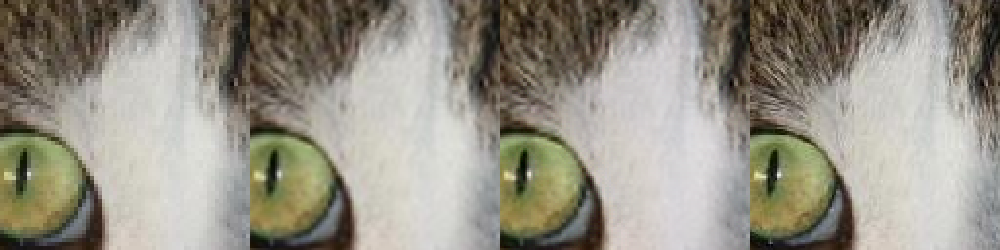

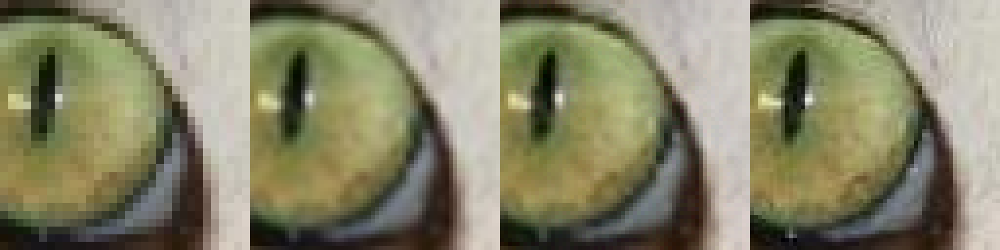

In [ ]:
test_set = load_images("/content/afhq/train/cat", 4)
test_set.append(test_image)

for test_image in test_set:
    corrected_image = cv2.cvtColor(predict_on_image(cv2.resize(test_image, (256, 256), interpolation=cv2.INTER_AREA), generator, device), cv2.COLOR_RGB2BGR)
    test_image = cv2.cvtColor(test_image, cv2.COLOR_RGB2BGR)
    input_image = cv2.resize(cv2.resize(test_image, (256, 256), interpolation=cv2.INTER_AREA), (512, 512), interpolation=cv2.INTER_NEAREST)
    cubic_image = cv2.resize(cv2.resize(test_image, (256, 256), interpolation=cv2.INTER_AREA), (512, 512), interpolation=cv2.INTER_CUBIC)

    imshow((np.concatenate([input_image, cubic_image, corrected_image, test_image], 1)))

    imshow((np.concatenate([cv2.resize(img, (512, 512), interpolation=cv2.INTER_NEAREST) for img in [input_image[164:292, 164:292], cubic_image[164:292, 164:292], corrected_image[164:292, 164:292], test_image[164:292, 164:292]]], 1)))

    imshow((np.concatenate([cv2.resize(img, (512, 512), interpolation=cv2.INTER_NEAREST) for img in [input_image[228:292, 164:228], cubic_image[228:292, 164:228], corrected_image[228:292, 164:228], test_image[228:292, 164:228]]], 1)))

In [ ]:
!rm ./*.pth

In [ ]:
target_images = load_images("/content/afhq/val/cat") + load_images("/content/afhq/val/dog") + load_images("/content/afhq/val/wild")
test_image = target_images.pop(1)
input_images = [cv2.resize(cv2.resize(img, (256, 256), interpolation=cv2.INTER_AREA), (512, 512), interpolation=cv2.INTER_NEAREST) for img in target_images]

train_inputs, val_inputs, train_targets, val_targets = train_test_split(
    input_images, target_images, test_size=0.2, random_state=42
)

train_dataset = ImageDataset(train_inputs, train_targets, transform=normalize_1_1)
val_dataset = ImageDataset(val_inputs, val_targets, transform=normalize_1_1)

train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False)

net = SimpleNet()
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(net.parameters(), lr=1e-3)

num_epochs = 20
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
net.to(device)

patience = 4
best_val_loss = float('inf')
no_improvement_epochs = 0

for epoch in range(num_epochs):
    net.train()
    running_train_loss = 0.0
    for inputs, targets in train_loader:
        inputs, targets = inputs.to(device), targets.to(device)

        outputs = net(inputs)
        loss = criterion(outputs, targets)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        running_train_loss += loss.item()

    net.eval()
    running_val_loss = 0.0
    with torch.no_grad():
        for val_inputs, val_targets in val_loader:
            val_inputs, val_targets = val_inputs.to(device), val_targets.to(device)

            val_outputs = net(val_inputs)
            val_loss = criterion(val_outputs, val_targets)
            running_val_loss += val_loss.item()

    avg_train_loss = running_train_loss / len(train_loader)
    avg_val_loss = running_val_loss / len(val_loader)

    print(f"Epoch [{epoch+1}/{num_epochs}], Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}")

    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        no_improvement_epochs = 0
        torch.save(net.state_dict(), "best_model.pth")
    else:
        no_improvement_epochs += 1

        if no_improvement_epochs >= patience:
            break

net.load_state_dict(torch.load("best_model.pth"))

files.download("best_model.pth")

print("Training complete")

Epoch [1/20], Train Loss: 0.0285, Val Loss: 0.0125
Epoch [2/20], Train Loss: 0.0238, Val Loss: 0.0077
Epoch [3/20], Train Loss: 0.0234, Val Loss: 0.0106
Epoch [4/20], Train Loss: 0.0218, Val Loss: 0.0087
Epoch [5/20], Train Loss: 0.0184, Val Loss: 0.0074
Epoch [6/20], Train Loss: 0.0147, Val Loss: 0.0111
Epoch [7/20], Train Loss: 0.0135, Val Loss: 0.0070
Epoch [8/20], Train Loss: 0.0131, Val Loss: 0.0059
Epoch [9/20], Train Loss: 0.0123, Val Loss: 0.0082
Epoch [10/20], Train Loss: 0.0102, Val Loss: 0.0064
Epoch [11/20], Train Loss: 0.0108, Val Loss: 0.0063
Epoch [12/20], Train Loss: 0.0102, Val Loss: 0.0067


<ipython-input-13-a3baf7fba4b4>:67: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  net.load_state_dict(torch.load("best_model.pth"))


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Training complete


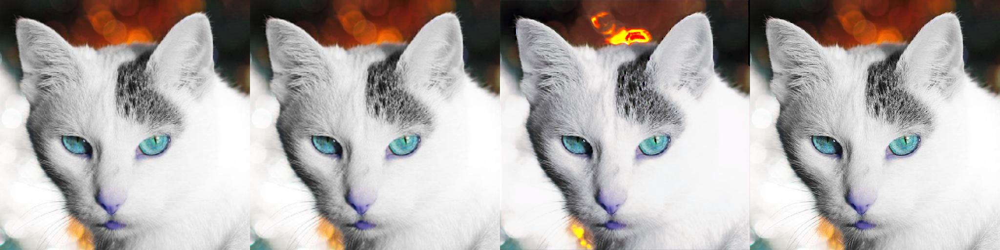

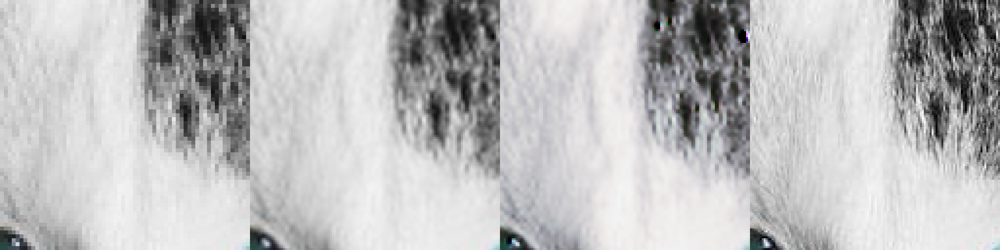

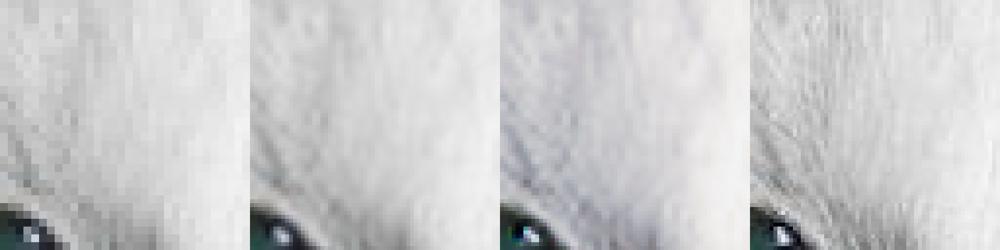

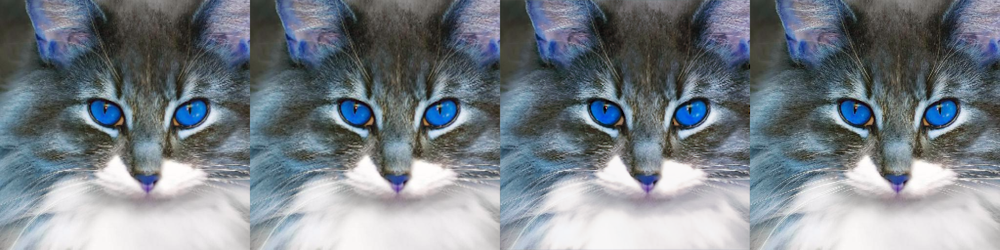

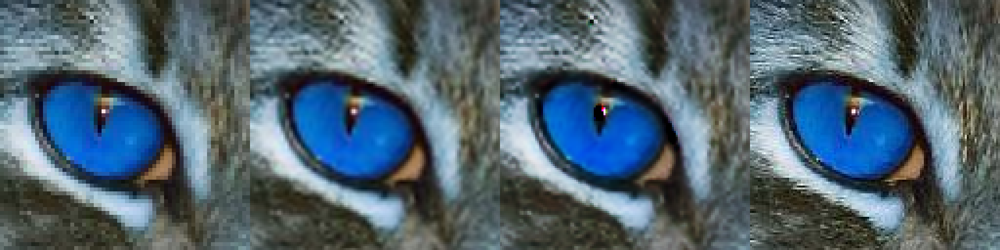

...

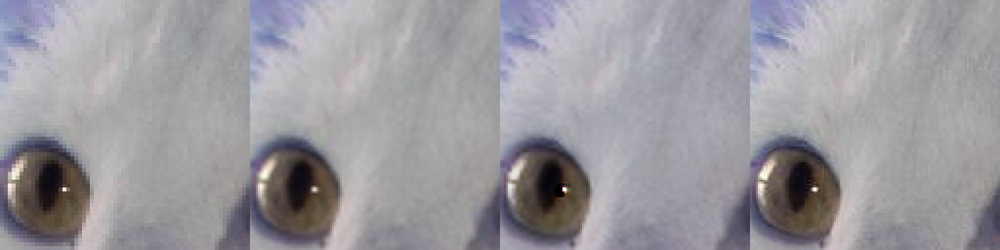

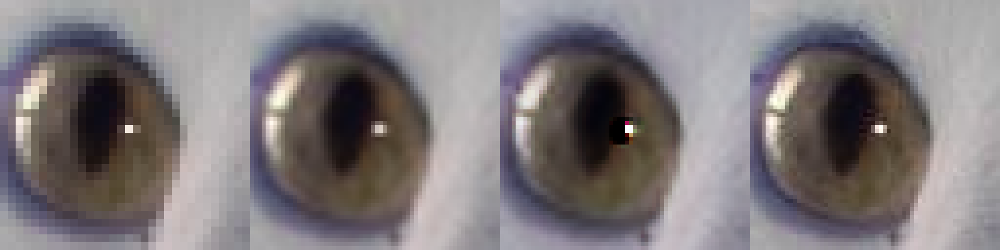

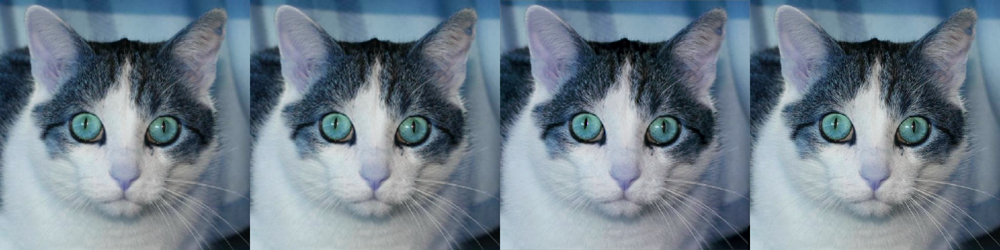

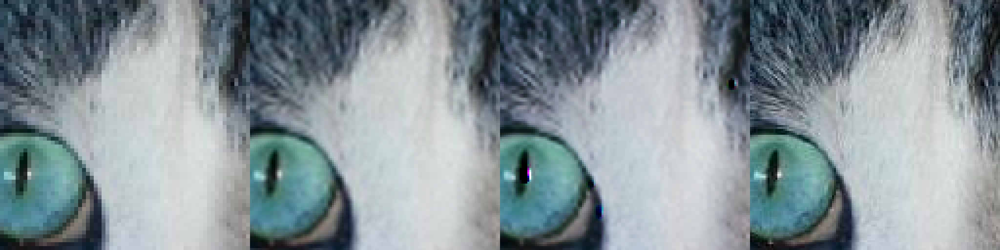

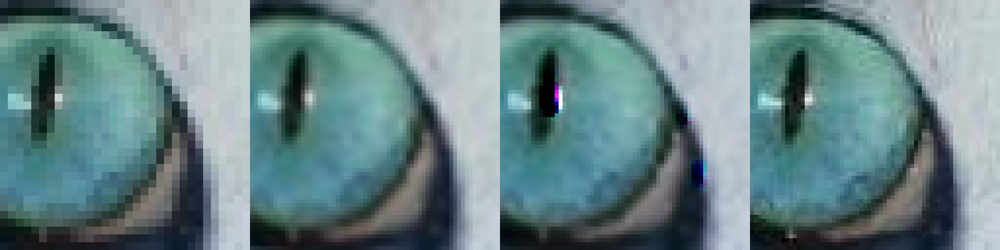

In [ ]:
test_set = load_images("/content/afhq/train/cat", 4)
test_set.append(test_image)

for test_image in test_set:
    corrected_image = cv2.cvtColor(predict_on_image(cv2.resize(test_image, (256, 256), interpolation=cv2.INTER_AREA), generator, device), cv2.COLOR_RGB2BGR)
    test_image = cv2.cvtColor(test_image, cv2.COLOR_RGB2BGR)
    input_image = cv2.resize(cv2.resize(test_image, (256, 256), interpolation=cv2.INTER_AREA), (512, 512), interpolation=cv2.INTER_NEAREST)
    cubic_image = cv2.resize(cv2.resize(test_image, (256, 256), interpolation=cv2.INTER_AREA), (512, 512), interpolation=cv2.INTER_CUBIC)

    imshow((np.concatenate([input_image, cubic_image, corrected_image, test_image], 1)))

    imshow((np.concatenate([cv2.resize(img, (512, 512), interpolation=cv2.INTER_NEAREST) for img in [input_image[164:292, 164:292], cubic_image[164:292, 164:292], corrected_image[164:292, 164:292], test_image[164:292, 164:292]]], 1)))

    imshow((np.concatenate([cv2.resize(img, (512, 512), interpolation=cv2.INTER_NEAREST) for img in [input_image[228:292, 164:228], cubic_image[228:292, 164:228], corrected_image[228:292, 164:228], test_image[228:292, 164:228]]], 1)))